In [1]:
import sys

sys.path.append('..')

%load_ext autoreload
%autoreload 2

In [2]:
import utils.coco_generator as coco
import utils.doors_generator as doors
import utils.imagenet_generator as imagenet
from models.siamese import build_siamese


import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
import keras.backend as K
import keras
import time
import cv2

%matplotlib inline

/scratch/home/aelphy/py27/local/lib/python2.7/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [3]:
BATCH_SIZE = 4

# Build model from scratch

In [4]:
model = build_siamese((256, 256, 3), 1024, 128, 'densenet')

# NOTE: doesn't work with keras
# model.compile(
#     loss=lambda y, x: tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels=y, logits=x)),
#     optimizer=keras.optimizers.RMSprop(1e-5),
#     metrics=[]
# )

labels = tf.placeholder(tf.float32, name='labels')

loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels=labels, logits=model.output))

global_step = tf.Variable(0, trainable=False)
train_step = tf.train.RMSPropOptimizer(1e-5).minimize(loss, global_step=global_step)
tf.add_to_collection('train_step', train_step)

sess = tf.Session()
sess.run(tf.global_variables_initializer())

input_1 = model.input[0]
input_2 = model.input[1]

# Pretrain model

In [5]:
# Imagenet
imagenet_headers = imagenet.load_headers_by_categories()
minibatch_generator = imagenet.MinibatchGenerator(imagenet_headers, BATCH_SIZE, 256, 256, positive='class').run()

# Coco
# coco_headers = coco.load_headers_by_categories()
# minibatch_generator = coco.MinibatchGenerator(coco_headers, BATCH_SIZE, 256, 256, positive='class').run()

In [6]:
import keras
import keras.backend as B

In [7]:
#train iter
for i in range(1000000):
    b_l, b_r, b_sim = minibatch_generator.next()

    _, l = sess.run([train_step, loss],
        feed_dict={input_1:b_l*255, input_2:b_r*255, labels: b_sim, K.learning_phase(): True})
    
#     summary_writer.add_summary(summary, i)

    if i % 100 == 0:
        print "\r#%d - Loss"%i, l
        
# for epoch in range(100):
#     x1, x2, y = minibatch_generator.next()
#     loss = model.train_on_batch([x1, x2], y)
#     print(loss)

#0 - Loss 1.4514828
#100 - Loss 16.347466
#200 - Loss 15.669838
#300 - Loss 16.632395
#400 - Loss 14.146703
#500 - Loss 21.956253
#600 - Loss 9.915582
#700 - Loss 19.863918
#800 - Loss 8.826969
#900 - Loss 8.178605
#1000 - Loss 6.042034
#1100 - Loss 0.38387743
#1200 - Loss 15.708532
#1300 - Loss 11.142832
#1400 - Loss 11.421801
#1500 - Loss 7.3104787
#1600 - Loss 9.430681
#1700 - Loss 15.735498
#1800 - Loss 19.593334
#1900 - Loss 3.1232932
#2000 - Loss 18.497734
#2100 - Loss 6.27419
#2200 - Loss 2.292945
#2300 - Loss 8.038523
#2400 - Loss 0.0047742077
#2500 - Loss 9.512419
#2600 - Loss 16.650383
#2700 - Loss 9.870979
#2800 - Loss 11.189062
#2900 - Loss 18.503956
#3000 - Loss 6.2218695
#3100 - Loss 6.767598
#3200 - Loss 15.511914
#3300 - Loss 23.500965
#3400 - Loss 9.611428
#3500 - Loss 15.135993
#3600 - Loss 6.5766554
#3700 - Loss 14.736643
#3800 - Loss 6.6230884
#3900 - Loss 2.4147134
#4000 - Loss 15.362658
#4100 - Loss 16.353004
#4200 - Loss 9.050569
#4300 - Loss 13.342751
#4400 - Lo

#35000 - Loss 6.243923
#35100 - Loss 7.9350996
#35200 - Loss 3.165359
#35300 - Loss 5.4893413
#35400 - Loss 0.72769403
#35500 - Loss 5.877841
#35600 - Loss 2.6652853
#35700 - Loss 3.9895396
#35800 - Loss 6.1820717
#35900 - Loss 1.3754596
#36000 - Loss 2.8504179
#36100 - Loss 14.8139515
#36200 - Loss 3.8388836
#36300 - Loss 1.1781219
#36400 - Loss 6.325669
#36500 - Loss 5.9816995
#36600 - Loss 10.578947
#36700 - Loss 11.9377165
#36800 - Loss 3.206798
#36900 - Loss 8.662116
#37000 - Loss 5.7084703
#37100 - Loss 8.76165
#37200 - Loss 8.217628
#37300 - Loss 4.5981374
#37400 - Loss 4.555756
#37500 - Loss 3.1206744
#37600 - Loss 0.033893887
#37700 - Loss 6.0460844
#37800 - Loss 1.4863613
#37900 - Loss 3.7442796
#38000 - Loss 1.1930183
#38100 - Loss 0.0008420368
#38200 - Loss 8.654169
#38300 - Loss 3.4327662
#38400 - Loss 7.3997793
#38500 - Loss 5.8388567
#38600 - Loss 2.6621177
#38700 - Loss 7.616807
#38800 - Loss 6.400694
#38900 - Loss 7.69841
#39000 - Loss 2.2684245
#39100 - Loss 8.98061
#

KeyboardInterrupt: 

# Write graph

In [7]:
graph_writer = tf.summary.FileWriter('../logs/', graph=tf.get_default_graph())
summary_writer = tf.summary.FileWriter('../logs/')
tf.summary.scalar('loss', loss)
merged = tf.summary.merge_all()

# Load pretrained weights

In [6]:
with np.load('../weights/siamese_pretrained_imagenet.npz') as f:
    param_values = [f['arr_%d' % i] for i in range(len(f.files))][0]

In [7]:
def reset_model_to_pretrained_state():
    for i, var in enumerate(tf.trainable_variables()):
        sess.run(var.assign(param_values[i]))

# Load doors

In [9]:
HAND_CRAFTED_PATH = '/home/mikhailu/Desktop/'
HAND_CRAFTED_ANNOTATION_PATH = '../data/hand_crafted_doors.txt'

In [11]:
Xc, Xd, y, wps = doors.load_data()

/scratch/home/aelphy/projects/guardian/data/doors/
(440, 480, 640, 3)
/scratch/home/aelphy/projects/guardian/data/doors/
(440, 480, 640, 4)
/scratch/home/aelphy/projects/guardian/data/doors/
(21, 480, 640, 3)
/scratch/home/aelphy/projects/guardian/data/doors/
(21, 480, 640, 4)
/scratch/home/aelphy/projects/guardian/data/doors/
(175, 480, 640, 3)
/scratch/home/aelphy/projects/guardian/data/doors/
(175, 480, 640, 4)
/scratch/home/aelphy/projects/guardian/data/doors/
(214, 480, 640, 3)
/scratch/home/aelphy/projects/guardian/data/doors/
(214, 480, 640, 4)


# Annotation

In [ ]:
import os
import ipywidgets

In [ ]:
# with open(HAND_CRAFTED_ANNOTATION_PATH, 'wb') as f:
#     for fname in os.listdir(HAND_CRAFTED_PATH):
#         im = plt.imread(os.path.join(hand_crafted_path, fname))
#         plt.imshow(im)
#         plt.show()
#         f.write('{}, {}\n'.format(fname, input()))

# Evaluation

In [12]:
sigmoid = lambda x: 1 / (1 + np.exp(-x))

def predict(model, inputs):
    return sigmoid(sess.run(model.output, feed_dict={model.input[0] : inputs[0]*255, model.input[1] : inputs[1]*255}))

def do_test(test_img, label):
    tets_metric1 = 0
    for batch in doors.test_iterate_minibatches(test_img, paired_doors_generator_object.closed_reference_doors, BATCH_SIZE):
        tets_metric1 += predict(model, batch).sum()
    mean1 = tets_metric1 / len(paired_doors_generator_object.closed_reference_doors)
    
    tets_metric2 = 0
    for batch in doors.test_iterate_minibatches(test_img, paired_doors_generator_object.open_reference_doors, BATCH_SIZE):
        tets_metric2 += predict(model, batch).sum()
    mean2 = tets_metric2 / len(paired_doors_generator_object.open_reference_doors)
    
    answer = np.argmin([mean1, mean2])
    
    return answer == label, (mean1, mean2), test_img

In [13]:
scores = []

for test_wp in set(wps[0]):
    Xc_open = Xc[(y==1) & (wps[0]!=test_wp)]
    Xc_closed = Xc[(y==0) & (wps[0]!=test_wp)]
    doors_generator = doors.MinibatchGenerator(Xc_open, Xc_closed, BATCH_SIZE).run()
    
    Xc_open_test = Xc[(y==1) & (wps[0]==test_wp)]
    Xc_closed_test = Xc[(y==0) & (wps[0]==test_wp)]
    
    paired_doors_generator_object = doors.PairMinibatchGenerator(Xc_open, Xc_closed, HAND_CRAFTED_PATH, HAND_CRAFTED_ANNOTATION_PATH, BATCH_SIZE)
    paired_doors_generator = paired_doors_generator_object.run()
    
    reset_model_to_pretrained_state()

    for i in range(500):
        b_l, b_r, b_sim = paired_doors_generator.next()

        _, l, summary = sess.run([train_step, loss, merged],
            feed_dict={model.input[0]:b_l*255, model.input[1]:b_r*255, labels: b_sim})

        if i % 100 == 0:
            print "\r#%d - Loss"%i, l

    for im in Xc_closed_test:
        scores.append(do_test(im, 0))

    for im in Xc_open_test:
        scores.append(do_test(im, 1))

#0 - Loss 0.754658
#100 - Loss 0.461209
#200 - Loss 0.0718921
#300 - Loss 0.00882801
#400 - Loss 0.000239517
#0 - Loss 0.746883
#100 - Loss 0.0277082
#200 - Loss 0.00285685
#300 - Loss 0.000699407
#400 - Loss 0.000130677
#0 - Loss 0.839763
#100 - Loss 0.0256785
#200 - Loss 0.00511909
#300 - Loss 0.00118396
#400 - Loss 3.21457e-05
#0 - Loss 0.843853
#100 - Loss 0.0129797
#200 - Loss 0.00384739
#300 - Loss 0.000683737
#400 - Loss 0.000220796
#0 - Loss 0.895968
#100 - Loss 0.170977
#200 - Loss 0.00985656
#300 - Loss 0.000806377
#400 - Loss 6.11268e-05
#0 - Loss 0.857128
#100 - Loss 0.0946327
#200 - Loss 0.219534
#300 - Loss 0.00368191
#400 - Loss 0.000271856
#0 - Loss 0.828528
#100 - Loss 0.0095955
#200 - Loss 0.000634046
#300 - Loss 3.73983e-05
#400 - Loss 5.13237e-05
#0 - Loss 0.74442
#100 - Loss 0.032899
#200 - Loss 0.00316784
#300 - Loss 0.000542829
#400 - Loss 0.0011471
#0 - Loss 0.865433
#100 - Loss 0.0178968
#200 - Loss 0.00527306
#300 - Loss 0.000564154
#400 - Loss 7.64128e-05
#0 

In [21]:
total = 0

for s in scores:
    total += s[0]

In [23]:
total / float(len(scores))

0.77882352941176469

In [24]:
import pickle

In [25]:
with open('../weights/scores', 'wb') as f:
    pickle.dump(scores, f)

True (0.00033030834876828722, 0.82115815815172699)
True (9.3864045791431432e-05, 0.98200647454512746)
True (5.9624741576650799e-05, 0.97915503853245789)
True (0.00015558774127081657, 0.98857924812718445)
True (0.00088158992326094047, 0.98766447368421051)
True (5.8377734805819476e-05, 0.99302984538831207)
True (4.8864950157520878e-05, 0.98329295610126699)
True (0.00016053067520260811, 0.99596221823441355)
True (3.2895741039990549e-05, 0.99111004879600129)
True (2.102391913973002e-05, 0.98634785100033406)
True (4.3646150313886916e-05, 0.96276004690872996)
True (3.3510143111925572e-05, 0.99247320074784129)
True (7.1142748412158748e-05, 0.99729635840968078)
True (3.4948522322035082e-05, 0.98550216775191457)
True (3.6701718878854685e-05, 0.97337258489508383)
True (4.072096231134815e-05, 0.99312355643824524)
True (0.00012305126357306208, 0.99826579344900035)
True (4.3450329637077324e-05, 0.98129332692999593)
True (0.0001044871120636041, 0.99808951428062043)
True (6.0495838018444679e-05, 0.92

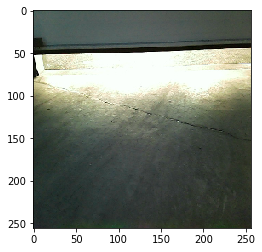

False (0.00010441562901380369, 0.02261017537430713)


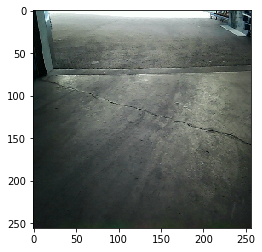

False (0.00011283708267405422, 0.043337598443031311)


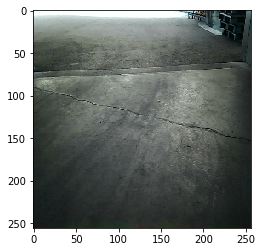

False (8.5236749631197498e-05, 0.30974031749524567)


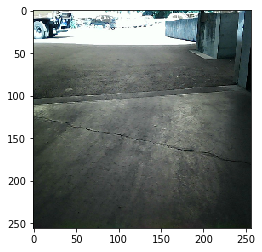

False (0.00012680548146211854, 0.30325602857690109)


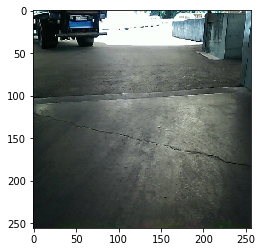

False (0.00024742524126648076, 0.16757871602710925)


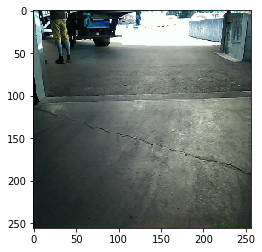

False (0.00099918006162624806, 0.0057553323475938098)


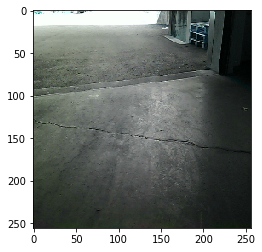

False (0.0001875686777768553, 0.042356914595553748)


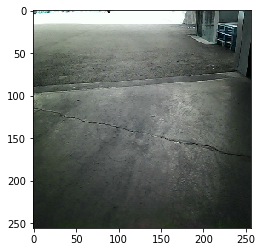

False (0.00028951410179918941, 0.0057996843794458795)


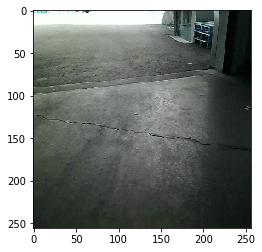

False (0.0002106805817068865, 0.032010592912372793)


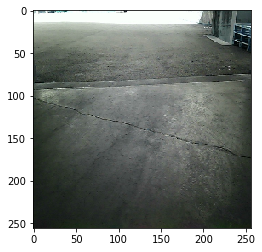

True (0.0019382356824482689, 0.0015251626456646544)
True (0.0033895312161702248, 0.0010100675403679673)
False (0.0002808833378367126, 0.0082417665735671393)


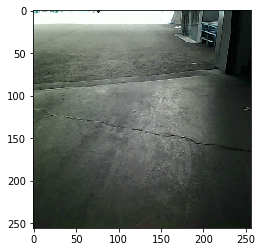

False (0.001604832864056031, 0.0019371478671306058)


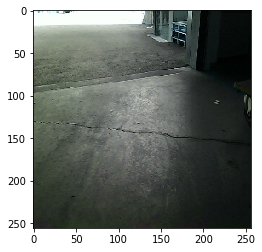

True (0.0056392649712506682, 0.00050778107374514401)
True (0.0022167986058371347, 0.0014447273539477273)
False (0.00056217963639129372, 0.0035396245749373186)


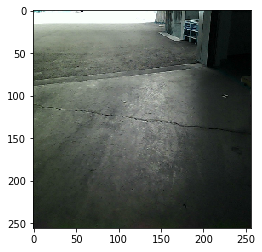

False (0.00012314408619810516, 0.027794482676606429)


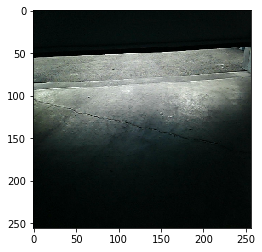

False (3.1927836567370425e-05, 0.1027653013405047)


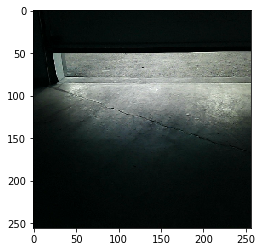

False (0.00013590621488725042, 0.013992153108119965)


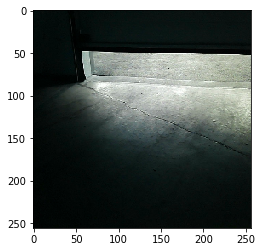

False (2.7781402928263156e-05, 0.16203317203019796)


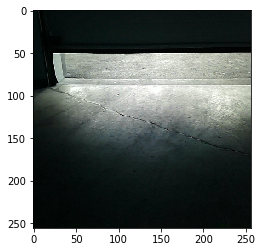

False (9.5586893015327704e-05, 0.046488372903121147)


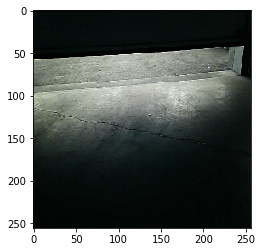

False (0.00016056314204130709, 0.020278434220113252)


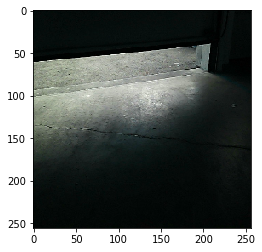

False (6.6793507458997833e-05, 0.071303831903558032)


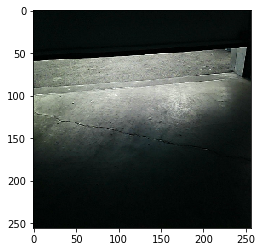

False (3.7254247318843329e-05, 0.088121660445865835)


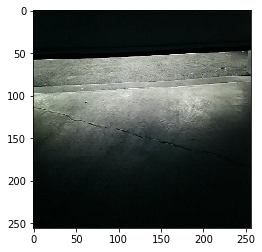

False (1.8818974543440465e-05, 0.084102439252953784)


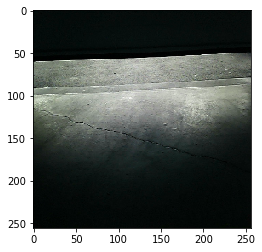

False (2.6013313698866921e-05, 0.081414465841494102)


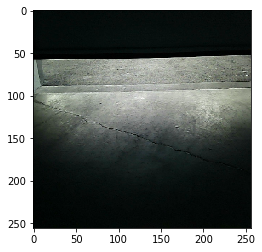

False (0.00011681099052414841, 0.030785411596298218)


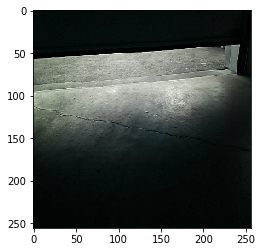

False (4.4388514955547485e-05, 0.10472836619929264)


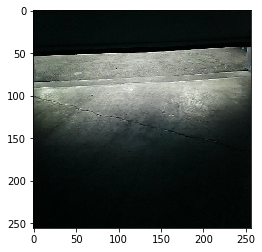

False (2.2751026537864367e-05, 0.055359834118893274)


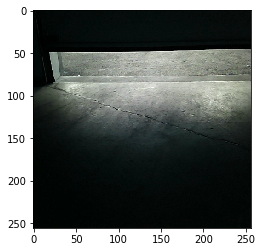

False (0.00014764351847892007, 0.10330957174301147)


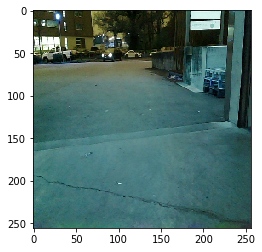

False (0.0002121567368804891, 0.024785061023737256)


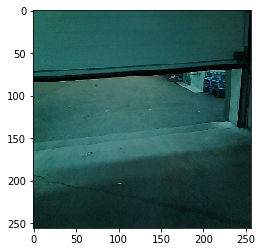

False (0.00017897037711615363, 0.17553123674894633)


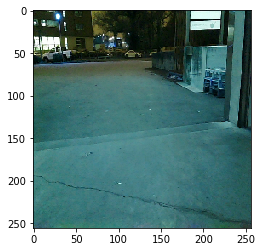

True (1.3940568452299987e-05, 0.98941469192504883)
True (2.7249896649866263e-05, 0.99644512879221059)
True (4.3267652169258026e-06, 0.76209364439311778)
True (8.4648153359820645e-06, 0.99168059700413758)
True (1.7484162526670843e-06, 0.96147968894556946)
True (5.9285370904641845e-05, 0.99395895004272461)
True (4.3131404304909265e-06, 0.97591319837068258)
True (6.2935037527091081e-06, 0.96972698914377309)
True (4.6166754448980401e-06, 0.95531827525088664)
True (4.3921601900365204e-05, 0.99670764019614777)
True (7.8121861507598719e-05, 0.99830655047768035)
True (3.2485416644097619e-05, 0.99511337280273438)
True (2.8739698690414014e-05, 0.9908854083011025)
True (7.4137527715518241e-05, 0.99660017615870422)
True (9.6560116314018771e-05, 0.99825934359901825)
True (0.00010293577441997413, 0.99858171061465617)
True (0.00016072068441038331, 0.99846137197394125)
True (5.899390574389448e-05, 0.99630446183054067)
True (4.2948947844302486e-05, 0.99582024624473175)
True (8.6017724242992699e-05, 0.9

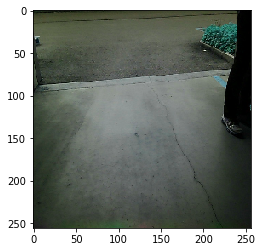

False (1.654160946095039e-06, 0.84687315790276774)


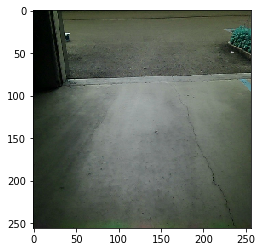

False (2.3433696141081682e-06, 0.92317147003976918)


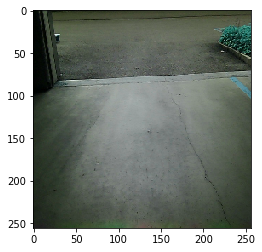

False (3.2135989284951293e-06, 0.71776006096287781)


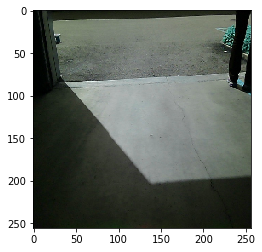

False (5.5894564259991357e-06, 0.29900033850418894)


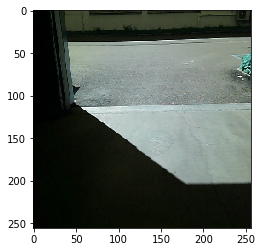

False (1.3576640918068329e-05, 0.12782771336404899)


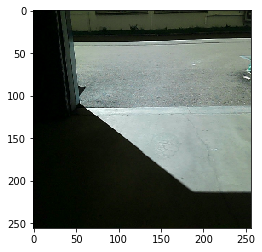

False (1.2632126324913568e-05, 0.064628977524606807)


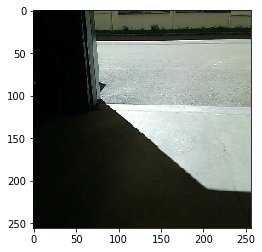

False (5.31313970794953e-06, 0.72721719741821289)


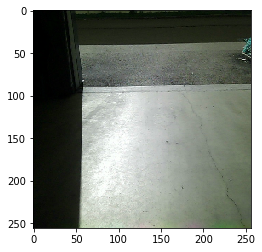

False (1.4561757350545829e-06, 0.45091646596005086)


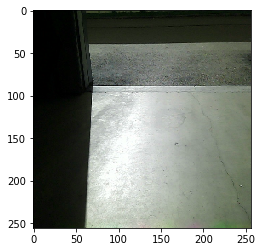

False (4.412430826050695e-06, 0.77498207594219004)


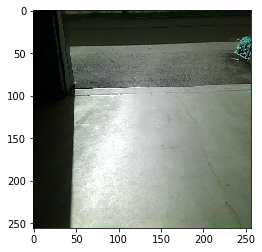

False (2.5223339687525167e-06, 0.79332976592214488)


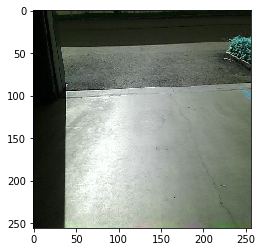

False (6.3760335857902348e-05, 0.0021387978800033267)


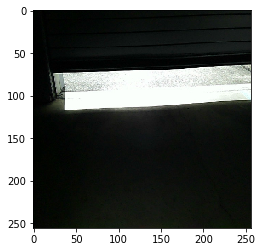

False (6.921343204642956e-05, 0.00099362160912469803)


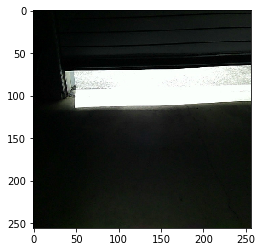

False (8.6252662489035473e-05, 0.0033444145596341081)


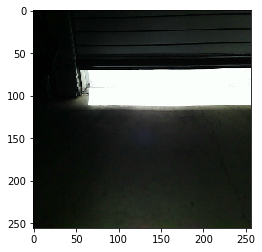

False (1.451590580674949e-05, 0.058366397493763975)


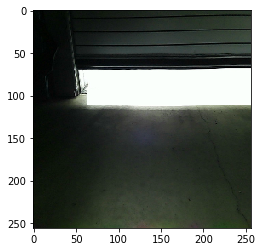

False (8.852533129457799e-06, 0.16494419072803698)


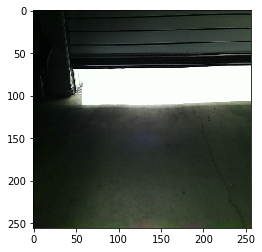

False (0.00026368413010560389, 0.0022515206303643552)


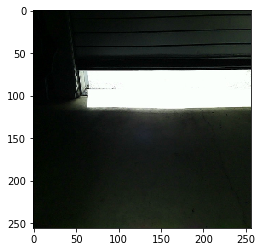

False (7.5405546441389656e-05, 0.0042576951121813368)


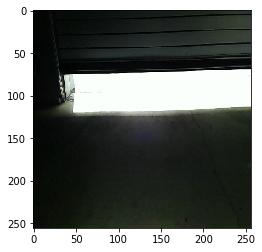

False (0.00012573665864894993, 0.002675044007207218)


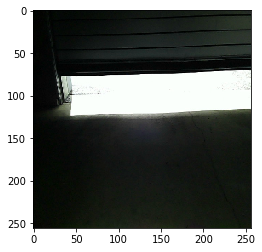

True (0.00033081286690301367, 0.00077653293939013233)
True (0.00014011329039931297, 0.00037487983507545372)
False (0.0047962190583348274, 0.0011374129374560557)


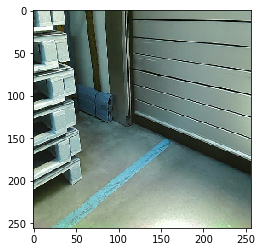

False (0.0013047870145075852, 0.00090059388036790649)


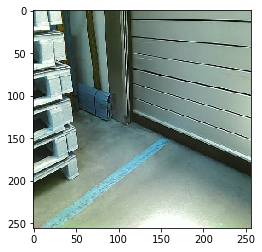

True (1.0531986238978183e-05, 0.00033331235968752911)
True (5.1923277270462779e-05, 0.00023551532802613159)
True (2.6098584688346211e-05, 0.00027325905638893967)
True (2.9474718556027961e-05, 6.8560267161381878e-05)
True (0.0010502519499924448, 0.00086037356308416317)
False (0.00075942390443136298, 0.0025529800669143073)


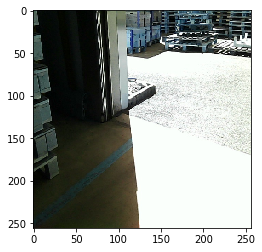

True (0.0018633673381474283, 0.00094147543667962681)
False (0.00064309689009355172, 0.0030368449852654807)


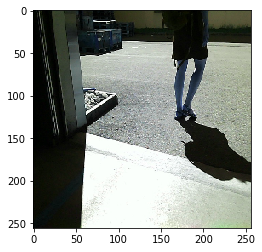

True (0.0026100925687286588, 0.0010689829819296535)
False (0.00084119745426707796, 0.0015849094641836065)


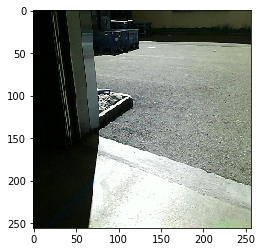

True (0.00062585527646458812, 0.00065524795239693245)
True (3.2826237656990997e-06, 0.79120979811015879)
True (5.0228557281823469e-06, 0.20360068271034643)
True (0.0003158939184181185, 0.00046457512010084957)
False (0.0012471727936321662, 0.00081922256044651329)


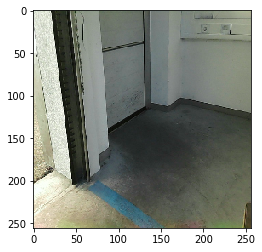

True (5.7347622512477555e-06, 0.43145365464059932)
True (3.9500612426005922e-05, 0.087247195996736221)
True (6.1066184975465556e-05, 0.064193852637943472)
True (0.00070323982961579331, 0.097630442757355537)
True (7.9935958233868914e-06, 0.34083544580559982)
True (0.00047108762858745951, 0.082453669686066475)
True (0.0019393059838977125, 0.062088605604673684)
True (0.0030273927582634818, 0.08793511359315169)
True (1.6455558781874264e-05, 0.23861288396935715)
True (4.5535035597923625e-06, 0.74601211045917715)
True (4.5100199107158305e-06, 0.67520480406911754)
True (0.00089370742595444119, 0.076662259666543262)
True (0.029755675544341404, 0.075654873722477964)
True (6.3014559701615426e-06, 0.76695502431769125)
True (5.3781192643024651e-06, 0.73889197801288808)
True (7.6391978735854428e-06, 0.72473641445762238)
True (5.9368387357810407e-06, 0.7036419416728773)
True (8.1228160221750532e-06, 0.74789820219341074)
True (9.9333657191083257e-06, 0.72269284097771891)
True (7.6476383886377643e-06,

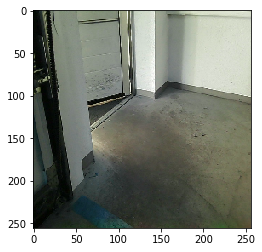

False (0.00020468454183881276, 0.0028618243768026956)


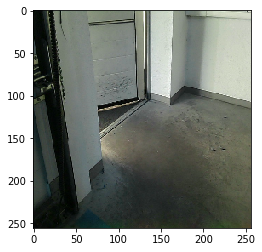

False (4.2544967679229252e-05, 0.021712852936041981)


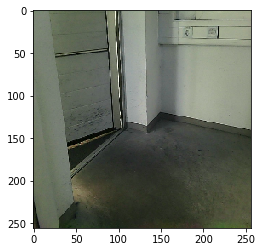

False (0.0005731319931025306, 0.0021909805210797409)


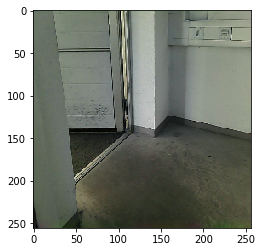

True (0.0062211327151291901, 0.00012770863740067733)
True (0.017561078899436526, 0.0019142375768799532)
True (0.0062939912572296131, 0.0055146340868974988)
True (0.0052950082915938562, 0.0052633248269557953)
False (0.0012088928682108719, 0.0049173102567070413)


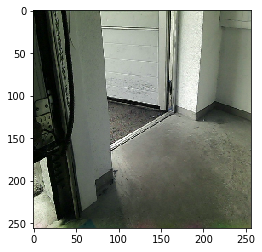

False (0.00031296877811352414, 0.0028876477950497679)


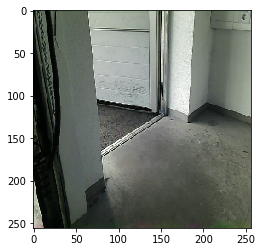

False (0.00053933345285865164, 0.0021430839735426402)


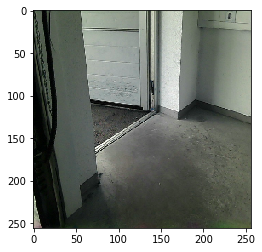

False (0.00014229272023334893, 0.0019443870865200694)


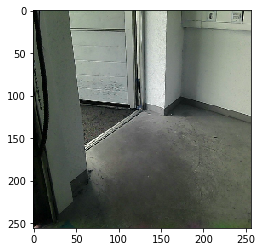

False (0.00018770308815874159, 0.0038155955507567056)


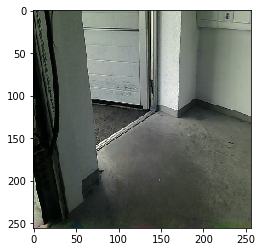

False (0.000750339919856439, 0.0070529356598854065)


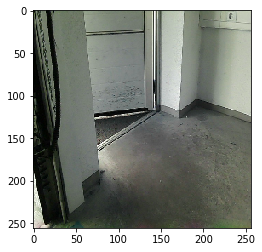

False (0.0011598002488931848, 0.0030180280537981737)


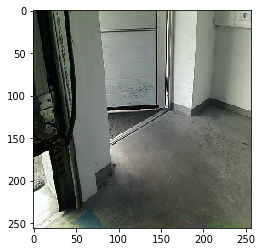

True (0.0086097087607615516, 0.0064629249666866501)
False (0.0039836765887836618, 0.012520763042726014)


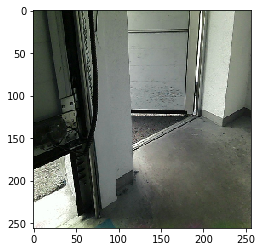

False (0.0077254374821980791, 0.0079395620054320288)


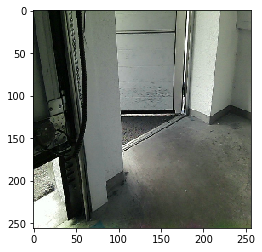

False (0.0078070173040032387, 0.026309113753469365)


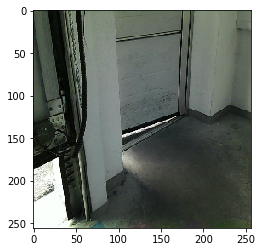

False (0.014860468192232979, 0.017551797393121217)


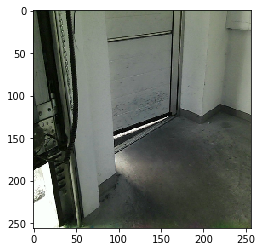

False (0.0004361354189717935, 0.030240353000791448)


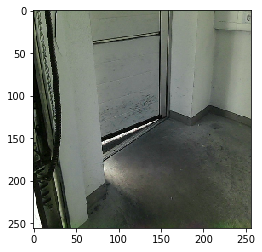

False (0.0013123539845562643, 0.033686815908080654)


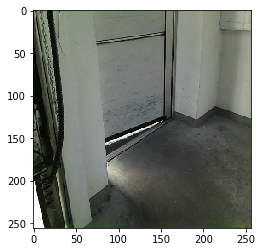

False (0.0021126782521605492, 0.050156888208891214)


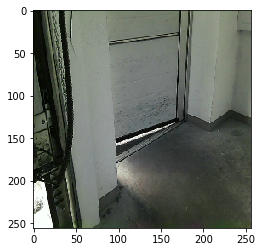

False (0.0028366835580931771, 0.081031788336603267)


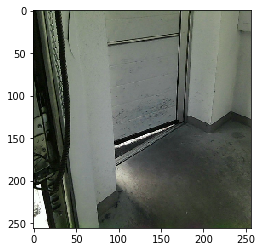

False (0.0022931183791822856, 0.11356858360139947)


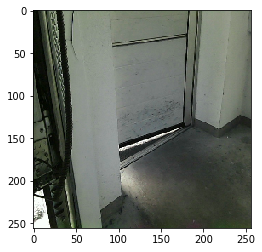

False (0.0018192016933527258, 0.08816570984689813)


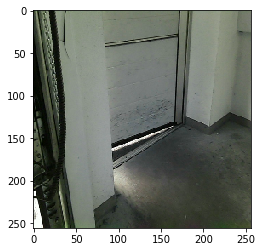

False (8.0597173817093586e-05, 0.030953837068457352)


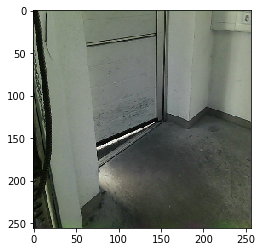

False (4.4689376308168803e-06, 0.8471924631219161)


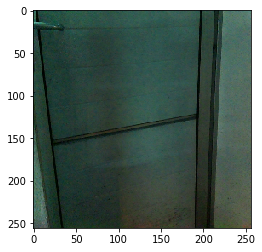

False (0.00012417724226704903, 0.81971271414505809)


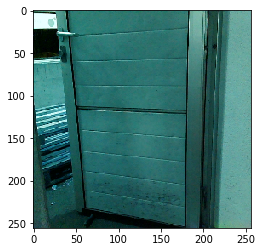

False (7.4129404513061876e-05, 0.50272482319882039)


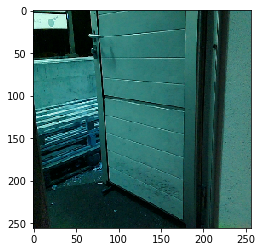

True (1.5894517774641928e-05, 0.98157089634945516)
True (2.7805443096440285e-05, 0.98495910042210633)
True (7.9117566605822904e-06, 0.98489643398084137)
True (7.0739054838971542e-06, 0.96877441908183848)
True (0.0012306715361773968, 0.061288596768128242)
True (3.9803601086734689e-06, 0.99115918811998871)
True (5.2649352760959627e-06, 0.9888666303534257)
True (2.7333257498361895e-06, 0.98736978832044098)
True (7.3861777006338045e-05, 0.99991336621736226)
True (5.0476432079449296e-05, 0.99982956836098114)
True (6.2838801467377285e-05, 0.99969050758763367)
True (3.4536804176039164e-05, 0.99842698950516551)
True (1.8994918920927579e-05, 0.99959958227057211)
True (8.3979804508595e-05, 0.99996637043200043)
True (1.1427623071035163e-05, 0.99934048401681996)
True (1.3417658111494449e-05, 0.99976765482049235)
True (1.3027933972706604e-05, 0.99979041752062348)
True (1.2271651939954609e-05, 0.99969121029502472)
True (2.2162700285358976e-05, 0.99972115064922129)
True (3.4683548922960959e-05, 0.999

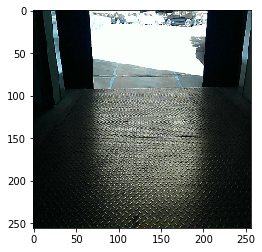

True (0.016658776698427066, 0.0029093487874457709)
True (0.043880431602398552, 0.005293967496407659)
True (0.0067249778140750192, 0.0025428901671579011)
True (0.0053934545463158023, 0.001586677212464182)
True (0.0013082037589305805, 0.00070036556816806923)
True (0.0017096949126830117, 0.00096325046922031204)
True (0.00056977085963202023, 0.00018386745604833491)
True (0.0020686771167675033, 0.00079074046133380184)
True (0.00038893764354320918, 0.00016094299989115251)
True (0.00070992718489530182, 0.0003096892431035246)
True (0.00073410935712874762, 0.00039506013701228718)
False (0.0007980156321233759, 0.00085769965631985346)


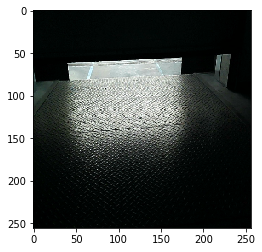

False (0.0010189475376844509, 0.0017743676067575027)


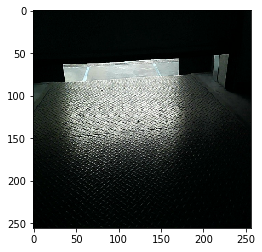

True (0.00072431223533284432, 0.00066912945016826451)
True (0.0020446407814031569, 0.00018122974219486902)
True (0.00077984085429408075, 0.00057619300327802956)
False (0.00023801347156727893, 0.0031079015155371869)


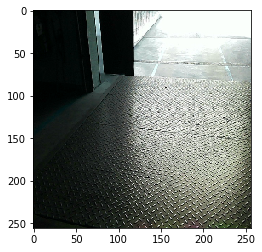

False (0.00010426049589619247, 0.00036945480448929101)


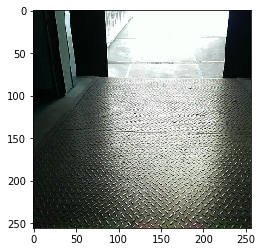

True (0.0037576352672961852, 0.00084101788601592968)
False (4.7831096202975866e-05, 0.070272037857457212)


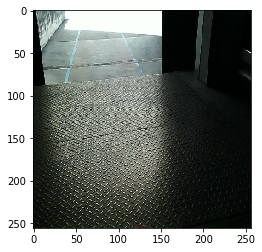

False (5.6601940337309818e-05, 0.031256129082880522)


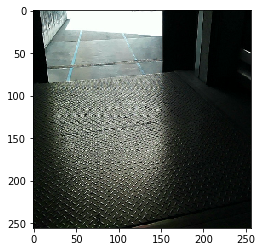

True (0.0023983545963548953, 0.00070664312347377598)
True (0.0081436275892580543, 0.00047858404975972677)
True (0.0088214020684568416, 0.00026853723561783368)
True (0.00063172800178613723, 0.00026027149655611108)
True (0.0015772364701357826, 3.7218946473378887e-05)
True (0.00096488007976505393, 4.6301916498984943e-05)
True (0.0009660516603212778, 3.0818220693618059e-05)
True (1.3357537151629609e-05, 0.99944413335699789)
True (1.2721109315963178e-05, 0.99776426114534078)
True (1.3562301319325343e-05, 0.99731011139719106)
True (1.3935260843330374e-05, 0.99987112848382242)
True (5.0618421028048033e-06, 0.99956919017590973)
True (1.6723970576195927e-05, 0.99990781984831156)
True (1.6516004153446476e-05, 0.99970212735627828)
True (1.7758326268651421e-05, 0.99923967060289887)
True (2.1322517884275134e-05, 0.99951513190018504)
True (1.8325896588875265e-05, 0.99955433293392781)
True (7.6366197592708177e-06, 0.99989108035438934)
True (3.2939339992784276e-05, 0.99995899200439453)
True (1.1332091

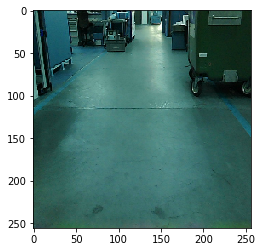

False (4.0046576537457033e-05, 0.01942631837568785)


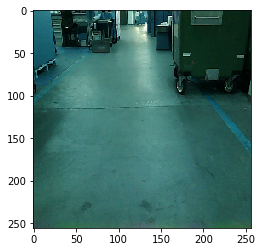

False (3.0152513166588808e-05, 0.035459604702497781)


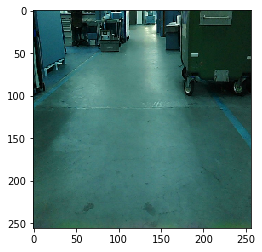

False (2.0412032578557653e-05, 0.016429403894825986)


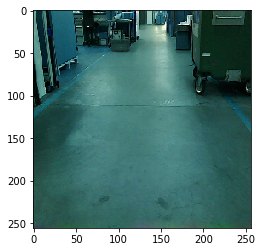

False (5.8273550368741984e-05, 0.01144324674418098)


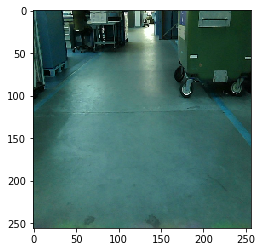

False (5.1096104256329352e-05, 0.0065616110437794733)


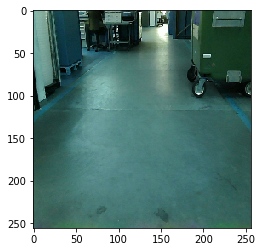

False (4.6108823729203628e-05, 0.0044732638879826196)


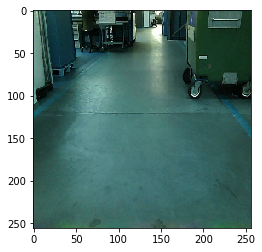

False (4.7522297121657984e-06, 0.75809109838385336)


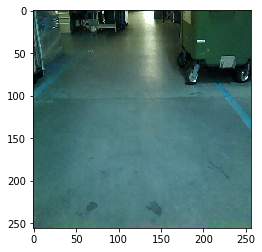

False (5.8364272869463702e-06, 0.20125811978390343)


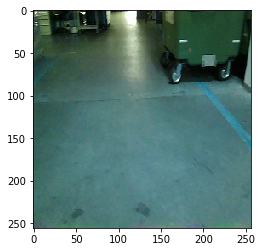

False (6.3759273574406607e-06, 0.51892023337514781)


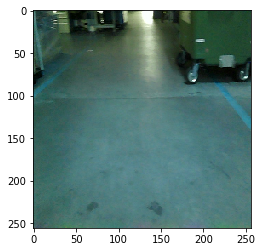

False (2.2698662923580237e-06, 0.40121362083836604)


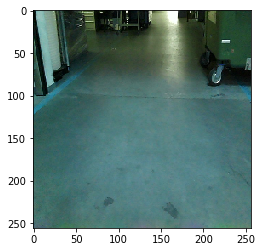

False (0.0002403102957436608, 0.010569631269103602)


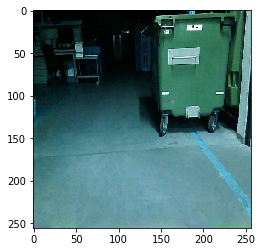

False (0.00069255709725742542, 0.025058663989368238)


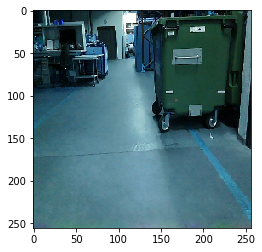

False (0.00016272521881748817, 0.005859889482197009)


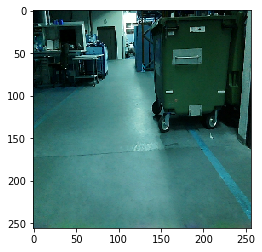

False (4.6996175165582419e-05, 0.0087633889756704633)


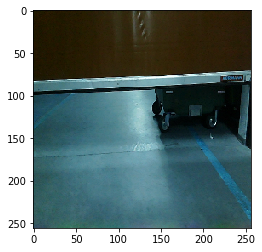

True (4.1573936471195339e-07, 0.99451617190712371)
True (5.045102429650999e-07, 0.9930822221856368)
True (6.4322627382454004e-07, 0.99773344240690531)
True (4.760465688807219e-07, 0.96284675598144531)
True (4.9707121579305954e-07, 0.90626001358032227)
True (3.8373845020108394e-07, 0.93047661530344106)
True (3.9938528888999121e-07, 0.9907096812599584)
True (8.4833827903215331e-07, 0.96987593801398031)
True (2.7542755418608067e-06, 0.037012823318180288)
True (4.4465852590115497e-07, 0.055696474878411541)
True (4.0353347054001966e-07, 0.40626402905112818)
True (1.084813766914926e-06, 0.089605215348695449)
True (1.3523641663305675e-06, 0.085159138629311015)
True (1.3091042671615267e-06, 0.0479290971630498)
True (1.4680753174110982e-06, 0.094046228810360552)
True (3.9019641128056213e-07, 0.16538876295089722)
True (1.1419929432716142e-06, 0.050638059252186826)
True (8.6897598094992645e-07, 0.061717146321346887)
True (4.6086127112074689e-07, 0.17775799726185046)
True (9.1484691545752458e-07, 

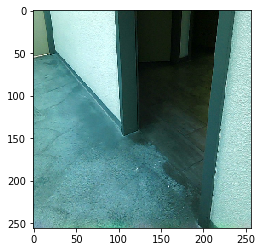

False (1.1042297103358578e-06, 0.023136657319570843)


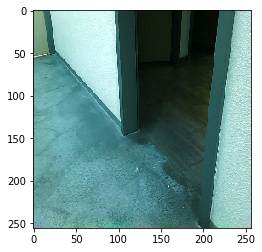

False (5.0632640361906545e-07, 0.055706668841211421)


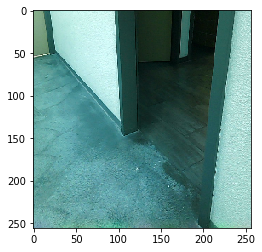

False (4.8979893642177149e-07, 0.97085945229781301)


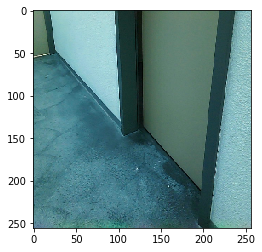

False (6.8272034386356813e-07, 0.9957992403130782)


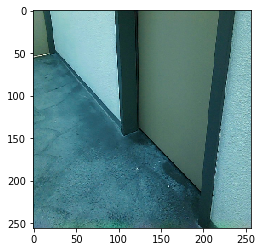

False (3.8615039067558933e-07, 0.15079003258755333)


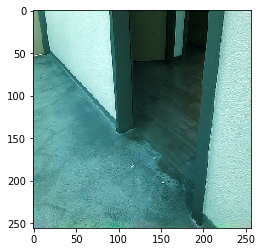

False (4.7419205549835573e-07, 0.095034643223411153)


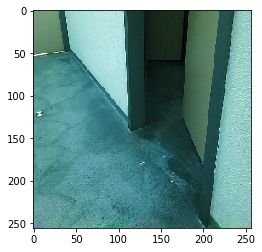

False (1.6248745661566015e-06, 0.022390475398615786)


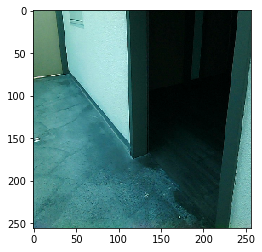

False (6.7161469215667091e-07, 0.0099619803460020764)


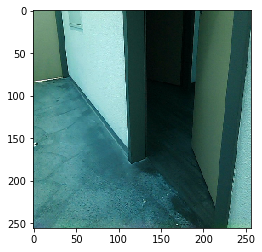

False (9.2952041145603437e-07, 0.10165873326753315)


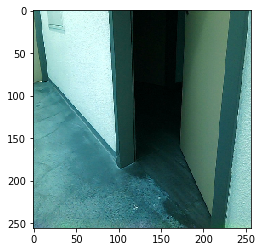

False (5.2605119865095025e-07, 0.17064853718406275)


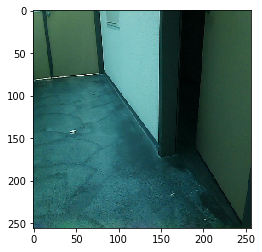

False (2.3711071924657922e-06, 0.059602194710781702)


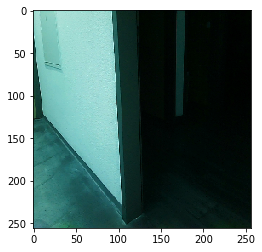

False (7.4650544282424862e-06, 0.29203856618780838)


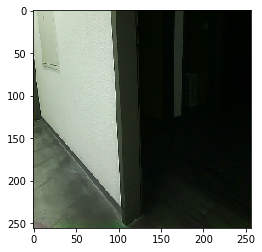

False (5.4406255098153151e-06, 0.0032956798217798535)


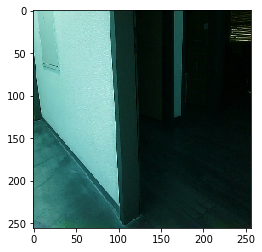

False (4.1942668960675492e-06, 0.00023933681414315574)


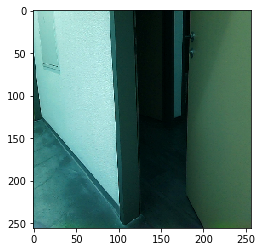

False (1.5442541629637517e-06, 0.0021248059837441695)


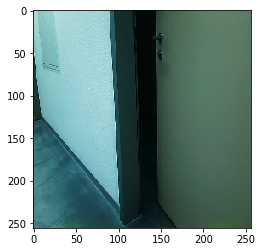

True (2.9660452759748699e-05, 0.91916214792351969)
True (5.6523789074465945e-05, 0.99309429369474711)
True (0.0015349719130123656, 0.99999312350624481)
True (0.00015427392544451222, 0.99934791263781098)
True (2.4640890943475017e-05, 0.97902767281783254)
True (0.00028229114023916837, 0.99995071009585734)
True (3.7300317975071572e-05, 0.99290503953632558)
True (9.0302348528186685e-06, 0.95492711820100484)
True (0.00083043460553098051, 0.99998637249595246)
True (7.2999616451044044e-05, 0.99987105319374481)
True (5.6243028262138571e-05, 0.99986011103579875)
True (0.0001328760707919072, 0.99993748413889028)
True (9.0569305434150417e-05, 0.99991487201891449)
True (0.0001293860324141052, 0.99991381795782797)
True (0.00037741977656777535, 0.99998945938913442)
True (0.00023511693062674667, 0.99996729900962433)
True (6.14526587822992e-05, 0.99990932564986379)
True (7.0605902389312788e-05, 0.9999310593856009)
True (8.4920732155700942e-05, 0.99989732943083109)
True (0.00012645724604630636, 0.99995

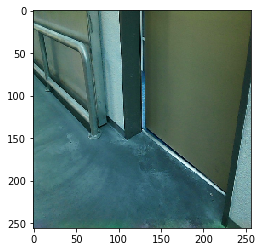

True (0.002623576826105515, 0.0019189351679463136)
False (0.0023192477722962699, 0.0032708205674823964)


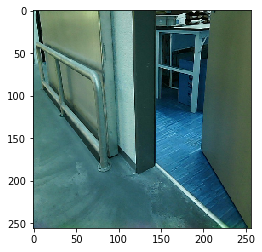

True (0.022343180659744475, 0.0026122450240348514)
False (1.1912833163781519e-05, 0.9273418125353361)


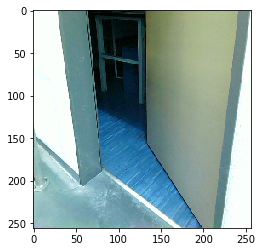

False (1.3416751800024132e-05, 0.77738515954268606)


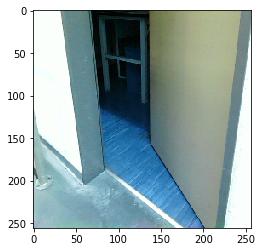

False (9.7887958771833729e-06, 0.61332670011018453)


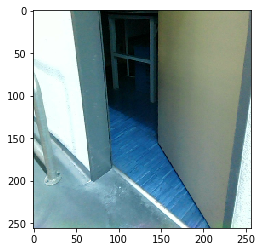

False (2.237684096447386e-05, 0.034700174080698115)


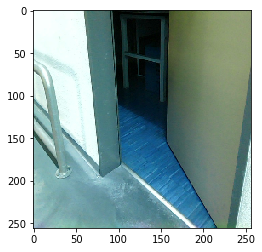

False (9.1642798906832468e-05, 0.0067084110096881262)


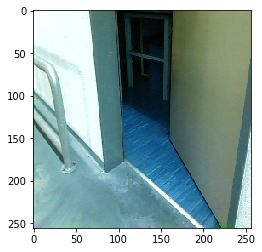

False (0.00012537244401755743, 0.0045845946787219302)


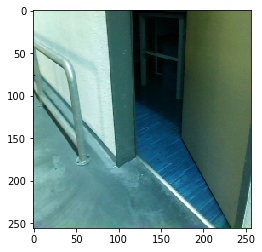

False (0.00030380229630585137, 0.00099712495054853599)


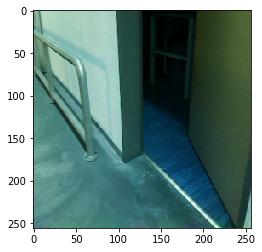

False (2.064508774108415e-05, 0.23913538455963135)


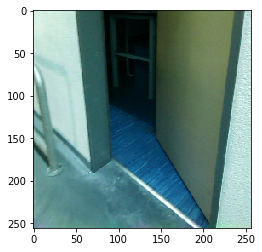

False (3.0791796638772619e-05, 0.99811824999357524)


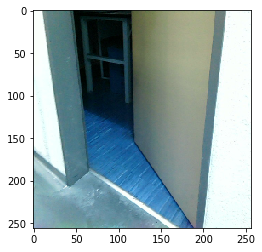

False (0.00021543444341255559, 0.99995924297131988)


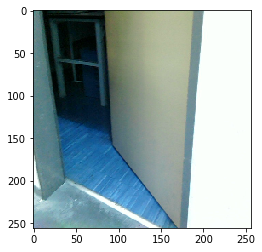

False (0.00018573814627921415, 0.99993981813129629)


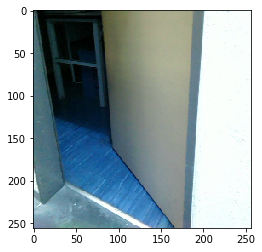

False (9.1140485488318111e-05, 0.99927744112516703)


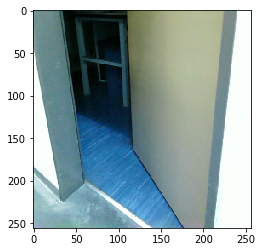

False (4.7371466886640214e-05, 0.99946506399857371)


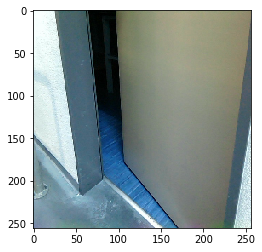

False (2.7681953724822961e-05, 0.9991270115501002)


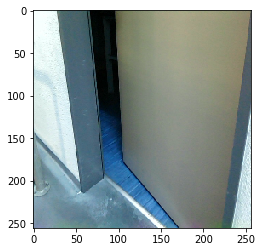

False (0.00010258111352514889, 0.99994001890483653)


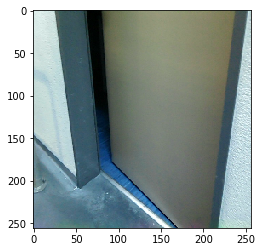

False (0.00015072740562674071, 0.9999366559480366)


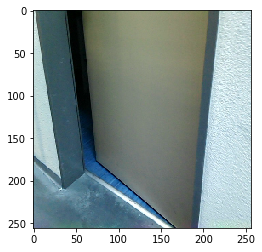

False (0.0004844130275564061, 0.99998408869693156)


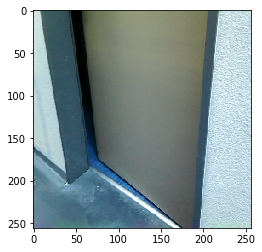

False (0.00030570431974613003, 0.99998644778602996)


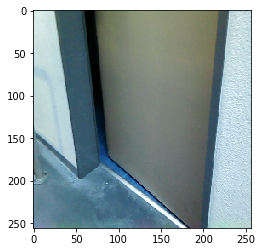

False (0.00018814330299695334, 0.9999362042075709)


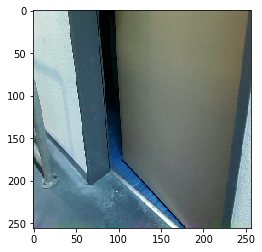

False (3.799309868352591e-05, 0.99904637587697886)


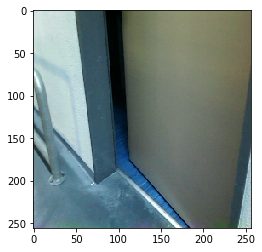

False (1.522513860486975e-05, 0.79956626892089844)


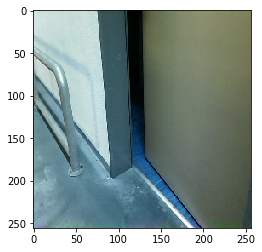

False (9.5205386161170376e-05, 0.004248466538755517)


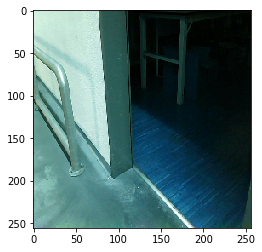

False (0.00033704006232761056, 0.012804264300747922)


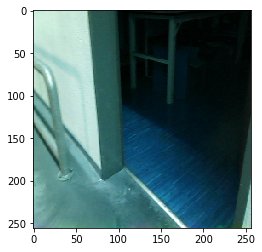

False (0.00016459294501045305, 0.030534867393343074)


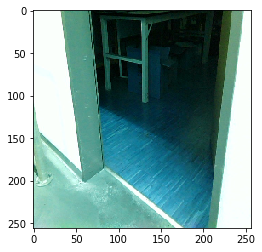

False (6.5997719098555128e-05, 0.09170222282409668)


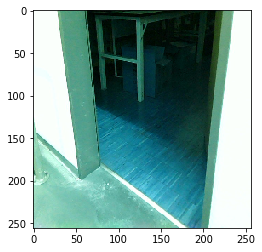

False (0.00018287335034175258, 0.060096946201826394)


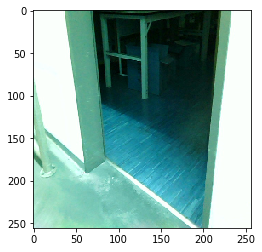

False (0.00022750472514114031, 0.026504948735237122)


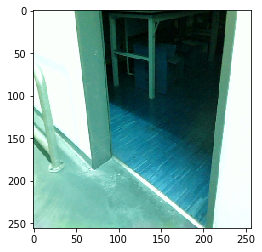

False (0.00084877911528261996, 0.0042174770251700751)


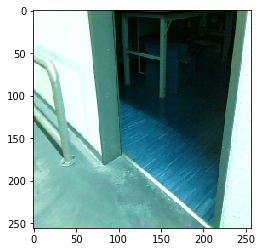

False (0.00049646192201180384, 0.0018845585321909503)


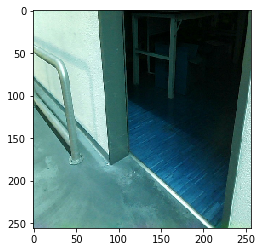

False (0.00052708667418402107, 0.0022003541357423131)


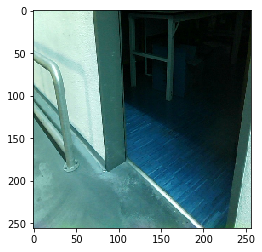

True (0.0050121924012071556, 0.0012867421794094537)
False (0.0002900075592656827, 0.0014445175367750619)


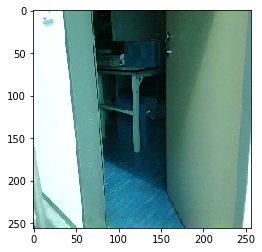

False (1.0188831967954886e-05, 0.73858301263106496)


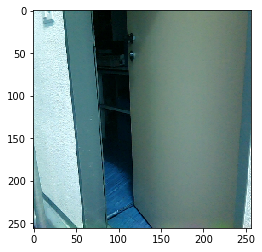

True (2.8140072774678829e-06, 0.96587098272223226)
True (3.4999877950920363e-06, 0.98780019659745066)
True (2.6932658177732569e-06, 0.9351330556367573)
True (1.8678297237784136e-06, 0.82574884515059621)
True (4.0680146563924309e-06, 0.88704829466970347)
True (6.1776447890022409e-06, 0.97924154683163289)
True (2.3112414055503905e-05, 0.99840636002390004)
True (7.1510882359386114e-06, 0.98387780942414937)
True (5.1320002967258915e-06, 0.98745614603946086)
True (1.7746732232303151e-05, 0.98431323703966644)
True (9.0398906549024906e-06, 0.99186596117521586)
True (5.1990720951127714e-06, 0.99672618665193258)
True (9.502823458104911e-06, 0.99833982869198445)
True (1.8400596066688497e-05, 0.99826192855834961)
True (5.9694902019044903e-06, 0.9971766722829718)
True (1.1338843250996433e-05, 0.99582850305657633)
True (1.2394996802969319e-05, 0.99526987577739512)
True (1.5160391639154921e-05, 0.99561741477564758)
True (4.9362889613904472e-06, 0.99275546324880504)
True (2.0519856762904155e-06, 0.99

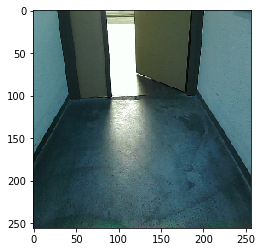

False (0.00017278619391921288, 0.0013385079555997723)


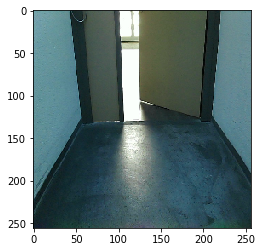

False (3.7310724615559188e-06, 0.49969892752797979)


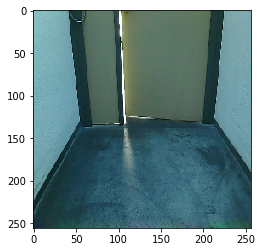

True (0.0027773456078850562, 8.4313353382688215e-05)
False (1.1999003921422021e-05, 0.087256754699506264)


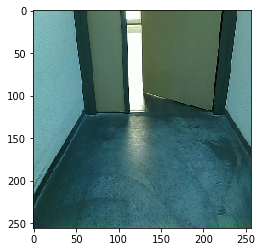

False (3.6121181084227928e-06, 0.26112764760067586)


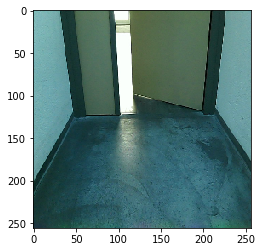

False (8.6542889524328838e-06, 0.0902855584495946)


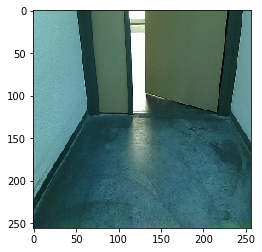

False (1.607268611931229e-05, 0.062819650298670718)


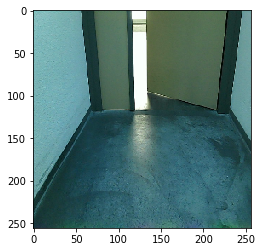

False (5.7955286997134354e-06, 0.25908959539313065)


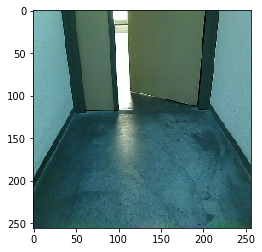

False (1.8596605918396057e-05, 0.074891608012349981)


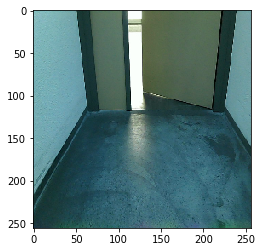

False (9.0514274436120304e-06, 0.18034880412252327)


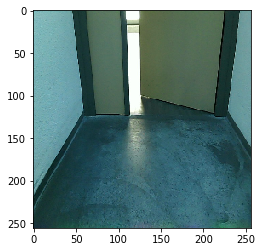

False (1.0585550828384132e-05, 0.13956024144825183)


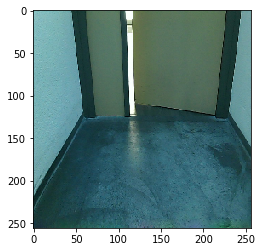

False (4.3221286129361642e-06, 0.89702104267321137)


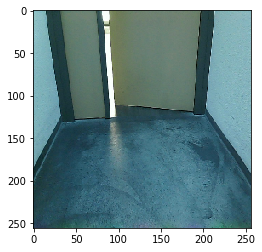

False (6.3090453497554536e-06, 0.38047836956224945)


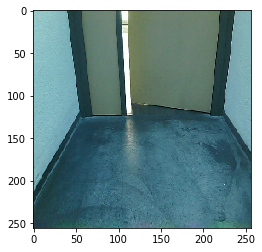

False (2.9725644405213338e-06, 0.85592149433336762)


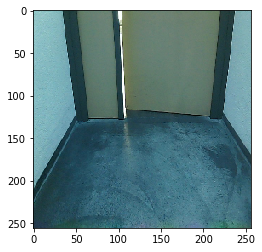

False (3.1374210165166814e-06, 0.68014335632324219)


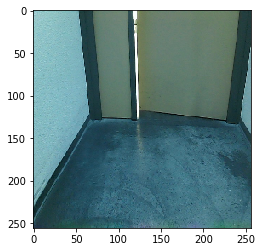

False (3.640232029687872e-06, 0.78053961302104746)


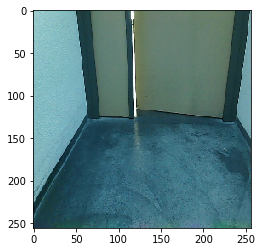

False (0.00023643591622304585, 0.0014706528990676528)


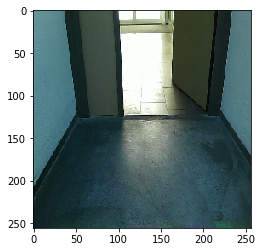

False (0.00046464923394119576, 0.0042516765625853284)


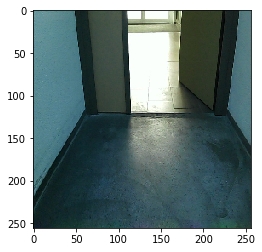

False (0.00014614858729247417, 0.0059571880847215652)


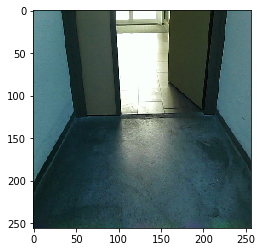

False (0.00017087360619269829, 0.010938388344488646)


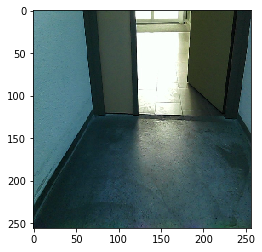

False (0.00048437940293095179, 0.00061209963046406448)


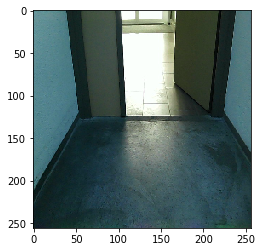

False (0.00016979335002057874, 0.0018957548921829776)


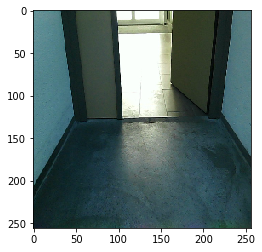

False (0.00016708896550375762, 0.0035439631166426758)


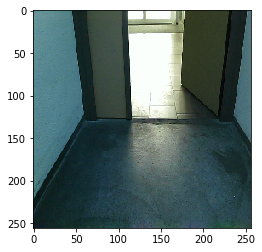

False (0.0005827857571097815, 0.00089075684694475254)


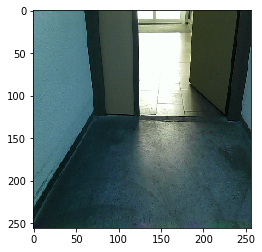

False (0.00034583037308443128, 0.0015513171735954913)


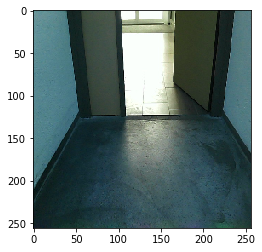

False (0.00013102820675056946, 0.0068751584346357147)


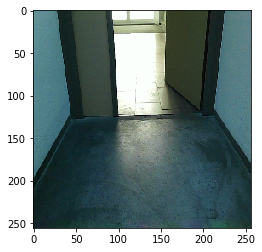

True (0.0013260388255326285, 0.00058853150173825651)
False (0.00015817442342975282, 0.0043650406755899127)


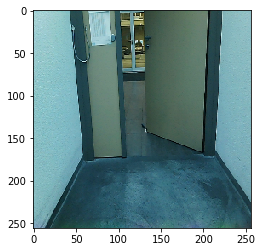

False (9.1098715529369656e-05, 0.01910104484934556)


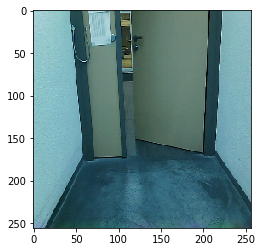

True (2.3539243380178555e-06, 0.8711677350495991)
True (3.1009021136520055e-06, 0.8684766418055484)
True (3.2172842262904546e-06, 0.82171766381514699)
True (2.2032057687384722e-06, 0.86234825535824422)
True (3.9975015447958467e-06, 0.74794179514834758)
True (2.5541291582461176e-06, 0.82078687768233449)
True (2.1994314288854689e-06, 0.8373561156423468)
True (1.1671198384040811e-06, 0.77209251805355672)
True (3.4794426003120152e-06, 0.9010055692572343)
True (2.5489143000514661e-05, 0.027540323765654313)
True (1.6299048790339537e-05, 0.16915507065622429)
True (3.8116552963805993e-06, 0.30946205791674164)
True (6.2380930406410095e-07, 0.40976436514603465)
True (3.4576331952646596e-06, 0.75832035667017883)
True (4.5864194615003525e-06, 0.79686079527202403)
True (3.0282394618552644e-06, 0.83301222951788656)
True (3.6014714623888722e-06, 0.75606383775409902)
True (3.4140543397774713e-06, 0.82483153594167613)
True (2.1129353437269551e-06, 0.92216918342991883)
True (2.15673330533011e-06, 0.8855

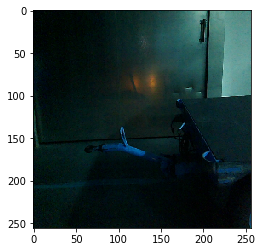

True (0.00026631687230999686, 0.00064273578065790623)
True (0.00016674016822232969, 0.00086985082414589435)
True (0.00026938178537723917, 0.00077102899453357647)
False (0.0061458743487795191, 0.0016918793614757689)


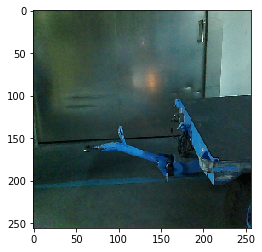

False (0.006716354646616512, 0.0050169437339431357)


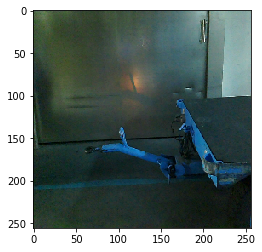

False (0.056475008527437844, 0.0036727030222353184)


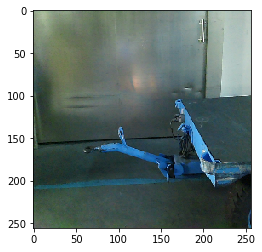

False (0.024549355109532673, 0.0073654028145890491)


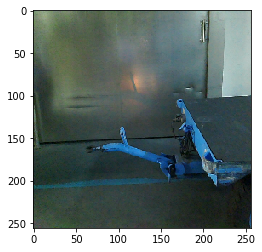

True (0.00026841332308120199, 0.000413170611289771)
True (0.00030477841695149738, 0.0005202974241815115)
True (0.00010863008436798636, 0.00066017011474621922)
False (0.00055999603581666528, 0.00032447093460512787)


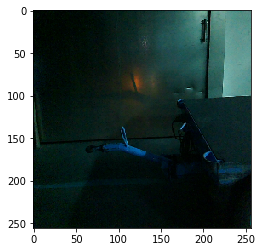

True (0.00030036370218214061, 0.00032796866358502914)
True (0.00021523604098345258, 0.0020002324722315137)
True (0.00019859072199324146, 0.0024272106391818901)
True (0.00017735736926422559, 0.002103718585873905)
True (0.00014389189083077427, 0.0039749839588215478)
True (9.26459700470635e-05, 0.00030009825959017401)
True (5.2158705026765041e-05, 0.0013694681815410916)
True (0.00013381943669325361, 0.00023537345451155774)
True (8.2767473334873401e-05, 0.00034532753603630945)
True (0.00011514789447472949, 0.00051095908948857536)
True (4.2448087697266601e-05, 0.00094744803285912464)
True (4.6572967524601459e-05, 0.00079818317470581909)
True (0.0001992225952562876, 0.00028279073855006382)
True (8.9264643773074364e-05, 0.00043421339145616482)
False (0.00034013056817154091, 0.00016612050393106123)


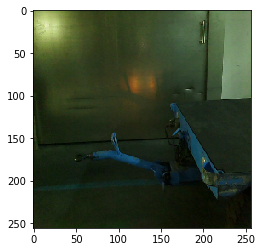

False (0.0011747730313800275, 0.00027067840442453558)


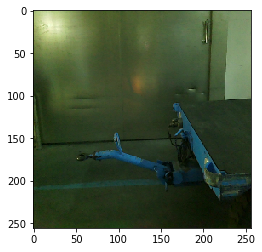

True (0.00038023710173244279, 0.00076930631736391464)
True (9.2411486548371613e-05, 0.00013002783893362473)
False (0.00019809655289767156, 0.00016663653628998682)


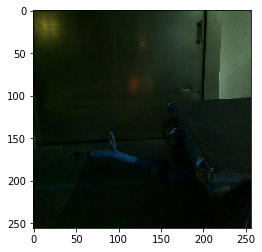

True (0.00018379652141852098, 0.0025918953316776375)
True (0.00023801349824579019, 0.00072014241136218369)
True (0.00010072710897980465, 0.0009927325391847837)
True (0.00036352157055969455, 0.00092870881780982018)
True (8.4984574237346853e-05, 0.00052279721651422352)
True (5.8973773169176034e-05, 0.00051667886835179836)
True (0.00011839803967935343, 0.00024828156088723948)
True (5.1541752933796182e-05, 0.00064572760541188091)
True (6.7084650355455874e-05, 0.00072402134537696838)


In [28]:
for s in scores:
    print s[0], s[1]
    if not(s[0]):
        plt.imshow(s[2])
        plt.show()